In [1]:
from myst_nb import glue

# HOW TO: Get and use OCR data from a book or periodical page

````{card}
On this page

```{contents}
:local:
:backlinks: None
```
````

````{margin}
```{seealso}
For information on getting positional information from newspaper articles see [](/newspapers-and-gazettes/how-to/get-ocr-coordinates.md).
```
````

The Optical Character Recognition (OCR) process extracts text from images. In doing so, it captures information about the *position* of each object on the page. This positional information isn't directly exposed in Trove, but it's used by the interface. For example, when you view a page in Trove's [digital book & journal viewer](interfaces:digitised-journal-viewer) it loads OCR data relating to that page using an internal API.

To access this API and download the OCR data for any page in a book or periodical you just need the page identifier. This [page](http://nla.gov.au/nla.obj-326405522) in *Pacific Islands Monthly* has the identifier `nla.obj-326405522`. To retrieve the OCR data you just add `/ocr` to the identifier: 

<a href="http://nla.gov.au/nla.obj-326405522/ocr">http://nla.gov.au/nla.obj-326405522/ocr</a>

## The structure of the data

The OCR data returned by the API is pretty dense and difficult for humans to parse. Here's a reformatted snippet that shows the basic structure.

```json
    "print": {
        "ps": [
            {
                "aid": 33456262,
                "ao": 1,
                "id": "P27_TB00001",
                "b": "432,260,1892,416",
                "ls": [
                    {
                        "id": "P27_TL00001",
                        "b": "432,264,1888,414",
                        "ws": [
                            {
                                "id": "P27_ST00001",
                                "b": "432,264,1006,414",
                                "w": "Sydneysider"
                            },
                            {
                                "id": "P27_ST00002",
                                "b": "1091,279,1307,365",
                                "w": "Goes"
                            },
                            {
                                "id": "P27_ST00003",
                                "b": "1383,281,1888,365",
                                "w": "Walkabout"
                            }
                        ]
                    }
                ]
            },
```

The data is arranged hierarchically. Blocks of text are labelled `ps` and contain an array of lines, labelled `ls`. Each line contains an array of words labelled `ws`. Each word includes a `w` value that provides the actual text content. Blocks, lines, and words all include a `b` property that provides the positional coordinates of the text object, formatted as a comma-delimited string. The coordinates are ordered: left, top, right, and bottom.

If the page includes illustrations, there might also be `zs` blocks in the OCR data, for example.

```json
        "zs": [
            {
                "aid": 33456262,
                "ao": 3,
                "id": "P27_CB00001",
                "b": "38,542,1484,1560",
                "t": "Content_Photo",
                "gr": [
                    {
                        "id": "P27_CB00001_SUB",
                        "b": "38,542,1484,1560"
                    }
                ]
            },
            {
                "aid": 33456262,
                "ao": 4,
                "id": "P27_CB00002",
                "b": "1983,135,2963,2224",
                "t": "Content_Photo",
                "gr": [
                    {
                        "id": "P27_CB00002_SUB",
                        "b": "1983,135,2963,2224"
                    }
                ]
            }
        ]
```

Each `zs` block describes an illustration. The `b` field provides the coordinates of the illustration, while the `t` field indicates the type. I've observed the following illustration types, but I'm not sure how consistently they're used:

- `Illustration`
- `Content_Photo`
- `Content_Map`
- `Content_Graph`
- `Content_Cartoon`
- `Content_Music`

The top level structure does seem to vary a bit. Sometimes, as in the example above, `print` is an object containing `ps` and `zs` keys. But other times, `print` is an array of `ps` and `zs` objects. I've also noticed some pages where the `ps` blocks are children of a `zs` block. If you want to capture the complete content of a page you'll need to accomodate these possibilities. The `get_blocks()` function in the code below attempts to do this.

(other-digitised:ocr-data:extract-blocks)=
## Extract blocks from the OCR data

As noted, the OCR data contains `ps` (text) and `zs` (illustration) blocks. The function below will extract the blocks from the data into a list, irrespective of the top-level structure.

In [2]:
def dict_extract(data, key):
    """
    Find keys wherever they are in dict/lists.
    From https://stackoverflow.com/a/29652561
    """
    if hasattr(data, 'items'): 
        for k, v in data.items(): 
            if k == key:
                yield v
            if isinstance(v, dict):
                for result in dict_extract(v, key):
                    yield result
            elif isinstance(v, list):
                for d in v:
                    for result in dict_extract(d, key):
                        yield result

def get_blocks(data, type="ps"):
    """
    Retrieve a list of blocks of the desired type
    """
    blocks = []
    for block in dict_extract(data, type):
        blocks += block
    return blocks

Here's an example retrieving the OCR data from the page with the identifier `nla.obj-326405522` and then extracting the text blocks.

In [3]:
import requests

page_id = "nla.obj-326405522"
response = requests.get(f"http://nla.gov.au/{page_id}/ocr")
data = response.json()

text_blocks = get_blocks(data, "ps")

Once you have the text blocks you can extract information about lines and words. This code prints the text from the first three blocks, one line at a time.

In [4]:
for block in text_blocks[:3]:
    for line in block.get("ls", []):
        words = line.get("ws", [])
        print(" ".join([w["w"] for w in words]))

Sydneysider Goes Walkabout
Take Me For An
ELEPHANT
The Outspan Hotel, Nyeri, Kenya.
Probably one of the most surprising things that this tourist
nket—pardon me, safari —through Kenya has taught us is that
•/- {E.A. or Stg .) will keep an elephant in water for a year.


(other-digitised:ocr-data:page-layout)=
## Visualise page layout

The most interesting thing about the OCR data is the positional information. It enables us to explore the structure and layout of published pages, rather than just their content. Here's a simple example which visualises the position of each text and illustration block. It uses the OCR data downloaded above, using the block coordinates to draw coloured rectangles on a blank canvas.

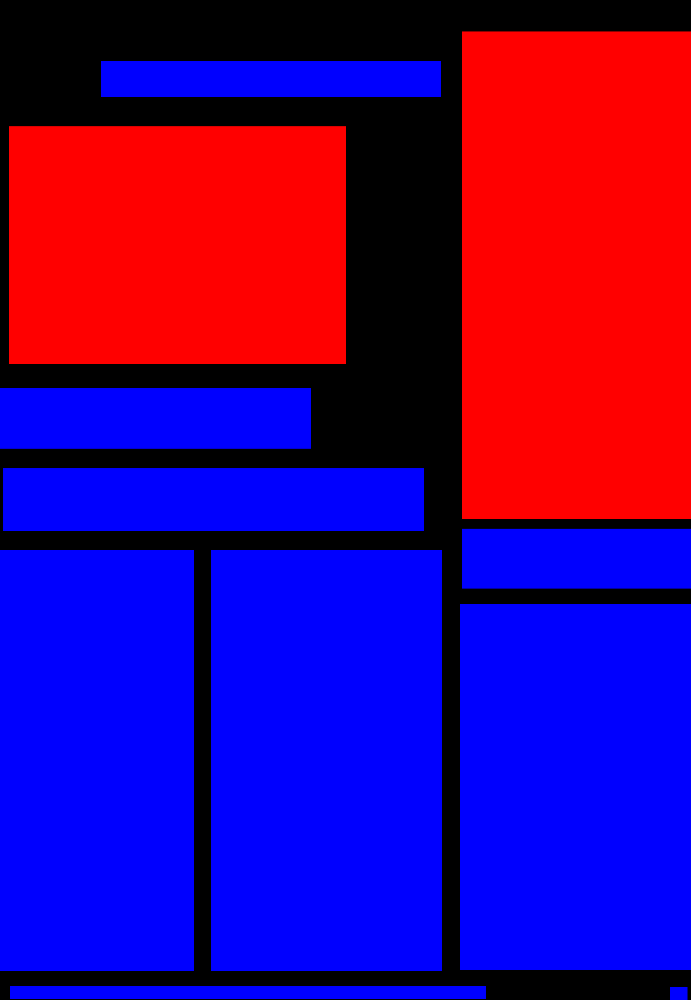

In [5]:
from PIL import Image, ImageDraw


def get_coords(blocks):
    coords = []
    for block in blocks:
        left, top, right, bottom = block["b"].split(",")
        coords.append([int(left), int(top), int(right), int(bottom)])
    return coords


# Get the text and illustration blocks from the OCR data downloaded above
text_blocks = get_blocks(data, "ps")
ill_blocks = get_blocks(data, "zs")

# Get lists of coordinates for text and image blocks
text_coords = get_coords(text_blocks)
ill_coords = get_coords(ill_blocks)

# Combine all the coordss to find the boundaries
combined = text_coords + ill_coords
# The width is the highest right value
width = sorted([c[2] for c in combined])[-1]
# The height is the highest bottom value
height = sorted([c[3] for c in combined])[-1]

# Create an empty image based on the height and width
img = Image.new("RGB", (width, height))
page_map = ImageDraw.Draw(img)

# Add text blocks to the image
for coords in text_coords:
    # Draw a blue rectangle using the coords
    page_map.rectangle([c for c in coords], "blue")

# Add illustration blocks to the image
for coords in ill_coords:
    # Draw a red rectangle using the coords
    page_map.rectangle([c for c in coords], "red")

display(img)

In [6]:
glue("layout_img", img, display=False)

Here's the OCR block layout displayed alongside an image of the page itself, enabling you to compare the location of page features and understand how they're represented in the OCR data.

`````{grid}
````{grid-item}
```{glue:figure} layout_img
:name: layout-img
:width: 300px
OCR block layout of page [nla.obj-326405522](https://nla.gov.au/nla.obj-326405522)
```
````
````{grid-item}
```{figure} /images/nla.obj-326405522.jpg
:width: 300px
:name: nla.obj-326405522

Image of page [nla.obj-326405522](https://nla.gov.au/nla.obj-326405522)
```
````
`````

(other-digitised:ocr-data:crop-images)=
## Crop images from pages using the OCR coordinates

````{margin}
```{seealso}
The GLAM Workbench notebook [Harvest illustrations from periodicals](https://glam-workbench.net/trove-journals/harvest-illustrations-from-periodicals/) demonstrates in detail how to use the OCR positional data to crop illustrations from the pages of periodicals. You can use it to harvest illustrations from articles, pages, issues, or a search in the *Magazines & Newsletters* category. Here's a <a href="https://www.dropbox.com/scl/fo/60imdoyf4ss2b6vh01q1w/h?rlkey=zuwbjaqnmr7qvkuinovdu5ot0&dl=0">collection of cat photos</a> harvested from a search for articles with `cat` or `kitten` in their title! 

![](/images/nla.obj-465109404-3.jpg)
```
````

One thing you might want to do is to crop text blocks or illustrations from the page image using the OCR coordinates. This is certainly possible, but it's not always straightforward. The problem is that the coordinates in the OCR data can sometimes refer to images at a higher resolution than those you can access through the web interface. If you try and use the coordinates with a lower resolution image you'll end up cropping out the wrong areas. The solution is to find the resolution of the image used in creating the coordinates and compare it to the one you've downloaded. Dividing the width of the low res image by the width of the high-res image will give you a ratio that you can apply to the coordinates to transform them for use with the downloaded image.

The original page resolutions are usually included in the metadata embedded in the digital journal viewer.

For example, if you download the page with the identifier [nla.obj-375667954](http://nla.gov.au/nla.obj-375667954/image) from *The Home* using the url hacking technique, you'll end up with an image that is 3804 pixels wide and 5000 pixels high. But if you find the page's details in the viewer's embedded metadata, you'll see the `technicalmetadata` field lists the width as 5068 pixels and the height as 6663 pixels. 

```json
{
    "id": "37566795",
    "subType": "page",
    "subUnitNo": "Vol. 3 No. 3 (1  September 1922)",
    "title": "The Home : an Australian quarterly.",
    "bibId": "2140655",
    "pid": "nla.obj-375667954",
    "form": "Journal",
    "accessConditions": "Unrestricted",
    "copyrightPolicy": "Out of Copyright",
    "sensitiveMaterial": "No",
    "bibLevel": "Part",
    "digitalStatus": "Captured",
    "holdingNumber": "NLq 059.44 HOM",
    "copies": [
        {
            "copyrole": "access",
            "blobId": 11937674,
            "filename": "37566803.jp2",
            "filesize": 2090840,
            "technicalmetadata": {
                "width": 5068,
                "height": 6663
            }
        },
        {
            "copyrole": "m",
            "access": "false",
            "filesize": 101309540
        }
    ]
}
```

```{warning}
I have noticed some instances where the `width` and `height` values in `technicalmetadata` are set to `0`. This will cause an error when you try to calculate the ratio.
```

Here's an example that calculates the page size ratio and extracts the first illustration from the page. It includes some code copied from [](/other-digitised-resources/how-to/extract-embedded-metadata.md) and the GLAM Workbench notebook [Harvest illustrations from periodicals](https://glam-workbench.net/trove-journals/harvest-illustrations-from-periodicals/). It also uses the `get_blocks()` and `get_coords()` functions defined above.

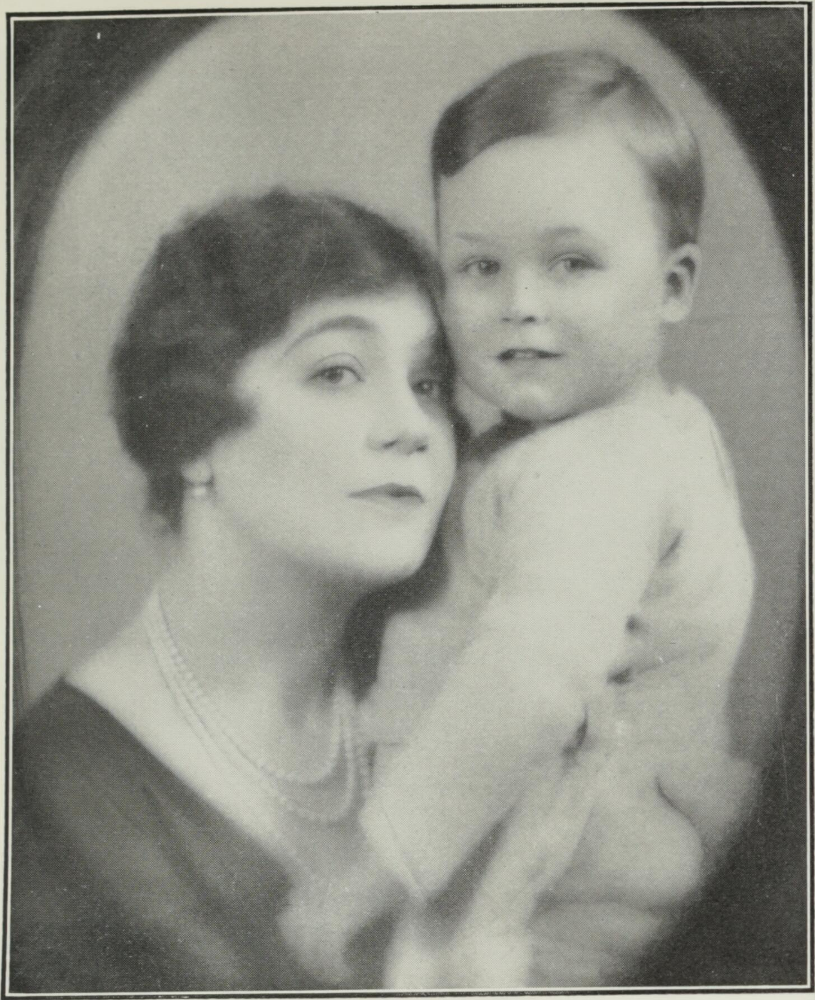

In [7]:
import json
import re
from io import BytesIO
from IPython.display import display, Image as DisplayImage

import requests
from PIL import Image

def get_metadata(id):
    """
    Extract work data in a JSON string from the work's HTML page.
    """
    if not id.startswith("http"):
        id = "https://nla.gov.au/" + id
    response = requests.get(id)
    try:
        work_data = re.search(
            r"var work = JSON\.parse\(JSON\.stringify\((\{.*\})", response.text
        ).group(1)
    except AttributeError:
        work_data = "{}"
    return json.loads(work_data)

def get_page_size(page_id):
    """
    Get the dimensions of the current page image from embedded metadata.
    """
    metadata = get_metadata(page_id)
    for page in metadata["children"]["page"]:
        if page["pid"] == page_id:
            break
    return page["copies"][0]["technicalmetadata"]

page_id = "nla.obj-375667954"

# Get the dimensions of the original image from embedded metadata
page_size = get_page_size(page_id)

# Download the page image
img_response = requests.get(f"https://nla.gov.au/{page_id}/image")
page_image = Image.open(BytesIO(img_response.content))

# Calculate the size ratio of the two page images
ratio = page_image.size[0] / page_size["width"]

# Get the OCR data
ocr_response = requests.get(f"http://nla.gov.au/{page_id}/ocr")
data = ocr_response.json()

# Get clocks containing illustrations
ill_blocks = get_blocks(data, "zs")

# Get the coordinates of all the illustrations
ill_coords = get_coords(ill_blocks)

# Apply the page size ration to the coordinates
coords = [c * ratio for c in ill_coords[0]]

# Crop the illustration from the page image using the coordinates
ill_img = page_image.crop(tuple(coords))

# You'll probably want to save the cropped image as a local file eg:
# ill_img.save(f"{page_id}".jpg")

display(ill_img)

In [8]:
glue("ill_img", ill_img, display=False)

`````{grid}
````{grid-item}
```{glue:figure} ill_img
:name: ill-img
:height: 400px
Cropped illustration
```
````
````{grid-item}
```{figure} /images/nla.obj-375667954.jpg
:height: 400px
:name: nla.obj-375667954

Complete image of page [nla.obj-375667954](https://nla.gov.au/nla.obj-375667954)
```
````
`````

## Play with words

````{margin}
```{seealso}
If you'd like to create scissors & paste messages using OCR data from digitised newspapers, see [Create 'scissors and paste' messages from Trove newspaper articles](https://glam-workbench.net/trove-newspapers/trove-newspapers-scissors-and-paste/) in the GLAM Workbench.
```
````

As noted above, the OCR data includes coordinates for all the page objects, including every word. You could use this to crop printed words from pages and create your own scissors and paste, 'ransom note' style messages. Or you could attempt some redaction art.

The example below 'redacts' random words from [a page](http://nla.gov.au/nla.obj-3083661207) of the *Australian Poetry Annual*. It extracts the coordinates of every word on the page, selects twenty at random, and then uses the coordinates to draw black boxes over the words in the page image.

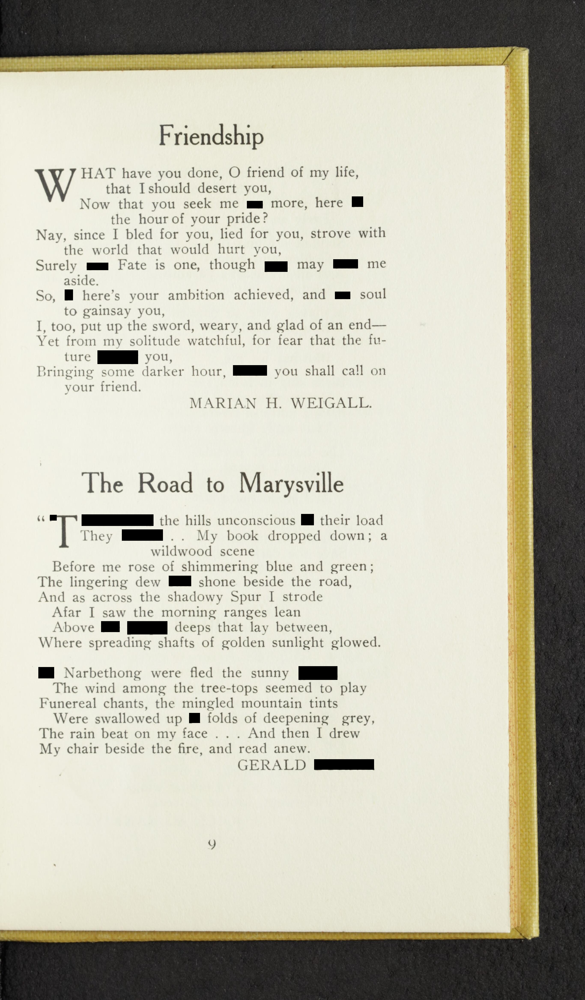

In [9]:
import random

page_id = "nla.obj-3083661207"

# Get the dimensions of the original image from embedded metadata
page_size = get_page_size(page_id)

# Download the page image
img_response = requests.get(f"https://nla.gov.au/{page_id}/image")
redacted_image = Image.open(BytesIO(img_response.content))

# Calculate the size ratio of the two page images
ratio = redacted_image.size[0] / page_size["width"]

# Get the OCR data
ocr_response = requests.get(f"http://nla.gov.au/{page_id}/ocr")
data = ocr_response.json()

# Get all the text blocks
text_blocks = get_blocks(data, "ps")

words = []
# Loop through text blacks and then lines saving the words
for block in text_blocks:
    for line in block.get("ls", []):
        words += line.get("ws", [])

# Get the coordinates of all the words
word_coords = get_coords(words)

# Get a random selection of words
target_words = random.sample(word_coords, 20)

# Open the page image for drawing
redacted = ImageDraw.Draw(redacted_image)

for coords in target_words:
    # Draw a black rectangle over the word using the coords
    redacted.rectangle([c for c in coords], "black")

display(redacted_image)

In [10]:
glue("redacted_image", redacted_image, display=False)

```{glue:figure} redacted_image
:name: redacted-image
:width: 500px

Some randomly-generated redaction art!
```